In [44]:
# Importing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [45]:
#load data and print a few rows 
df = pd.read_csv('https://github.com/ArinB/MSBA-CA-Data/raw/main/CA01/house-price-train.csv')
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [46]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

# **Part 1: Data Understanding**

In [47]:
#print all columns 
pd.set_option('max_columns',None)
df.head()

OptionError: 'Pattern matched multiple keys'

In [48]:
df.shape

(1460, 81)

In [49]:
#check describtive output for each col
df.describe().round(2)

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.00,1460.0,1201.00,1460.00,1460.00,1460.00,1460.00,1460.00,1452.00,1460.00,...,1460.00,1460.00,1460.00,1460.00,1460.00,1460.00,1460.00,1460.00,1460.00,1460.0
mean,730.50,56.9,70.05,10516.83,6.10,5.58,1971.27,1984.87,103.69,443.64,...,94.24,46.66,21.95,3.41,15.06,2.76,43.49,6.32,2007.82,180921.2
std,421.61,42.3,24.28,9981.26,1.38,1.11,30.20,20.65,181.07,456.10,...,125.34,66.26,61.12,29.32,55.76,40.18,496.12,2.70,1.33,79442.5
min,1.00,20.0,21.00,1300.00,1.00,1.00,1872.00,1950.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,2006.00,34900.0
25%,365.75,20.0,59.00,7553.50,5.00,5.00,1954.00,1967.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,5.00,2007.00,129975.0
50%,730.50,50.0,69.00,9478.50,6.00,5.00,1973.00,1994.00,0.00,383.50,...,0.00,25.00,0.00,0.00,0.00,0.00,0.00,6.00,2008.00,163000.0
75%,1095.25,70.0,80.00,11601.50,7.00,6.00,2000.00,2004.00,166.00,712.25,...,168.00,68.00,0.00,0.00,0.00,0.00,0.00,8.00,2009.00,214000.0
max,1460.00,190.0,313.00,215245.00,10.00,9.00,2010.00,2010.00,1600.00,5644.00,...,857.00,547.00,552.00,508.00,480.00,738.00,15500.00,12.00,2010.00,755000.0


In [10]:
df.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
                  ...   
MoSold             int64
YrSold             int64
SaleType          object
SaleCondition     object
SalePrice          int64
Length: 81, dtype: object

In [11]:
#check missing values in each columns 
df.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage      259
LotArea            0
                ... 
MoSold             0
YrSold             0
SaleType           0
SaleCondition      0
SalePrice          0
Length: 81, dtype: int64

In [12]:
#check % of missing values in each col 
df.isnull().sum() / len(df) 

Id               0.000000
MSSubClass       0.000000
MSZoning         0.000000
LotFrontage      0.177397
LotArea          0.000000
                   ...   
MoSold           0.000000
YrSold           0.000000
SaleType         0.000000
SaleCondition    0.000000
SalePrice        0.000000
Length: 81, dtype: float64

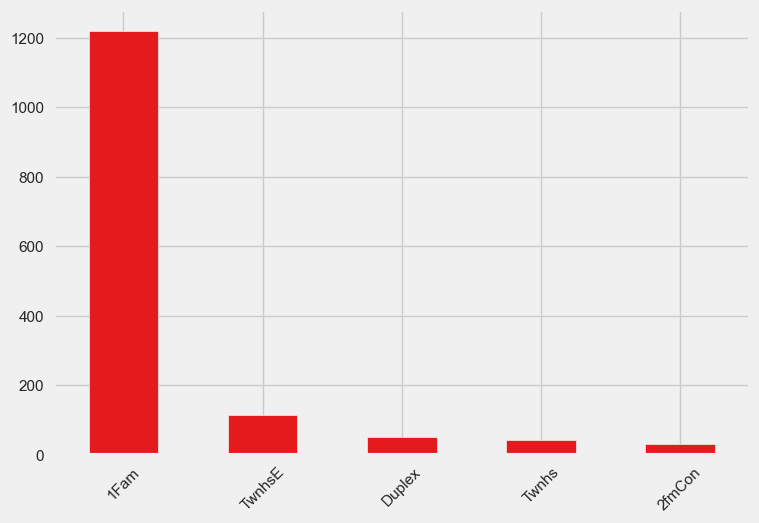

In [34]:
#viz the distribution of a categorical col 
df['BldgType'].value_counts().plot(kind = 'bar')
plt.xticks(rotation = 45)
plt.show()

Data Quality Issue: 
two col TwnhsE, Twnhs may be the same 

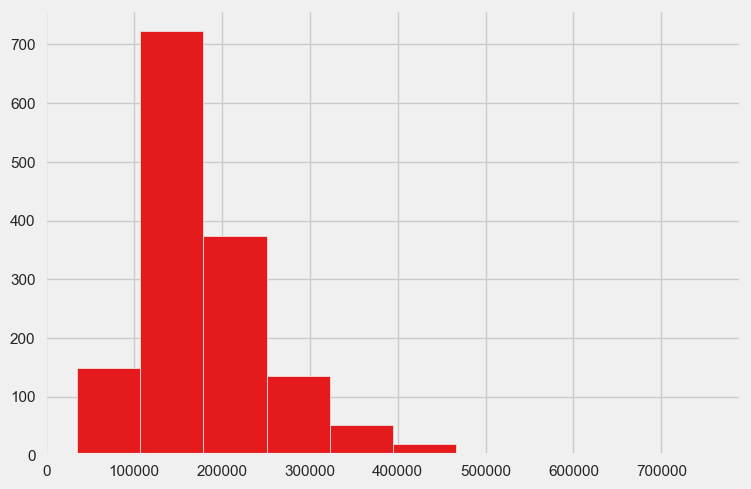

In [35]:
#viz the distribution of a numeric col 
plt.hist(df['SalePrice'])
plt.show()

Data Quality Issue: right skewed

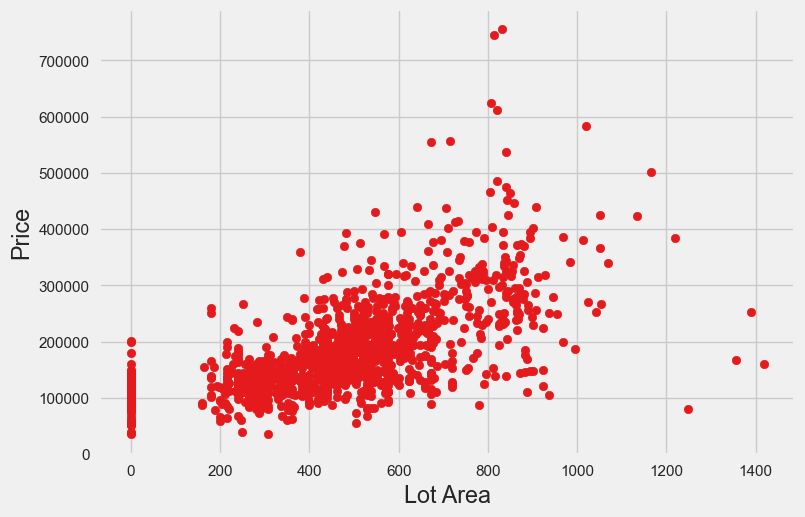

In [36]:
# create scatter plot to viz the relationship berween two numerical variables 
plt.scatter(df['GarageArea'], df['SalePrice'])
plt.xlabel('Lot Area')
plt.ylabel('Price')
plt.show()

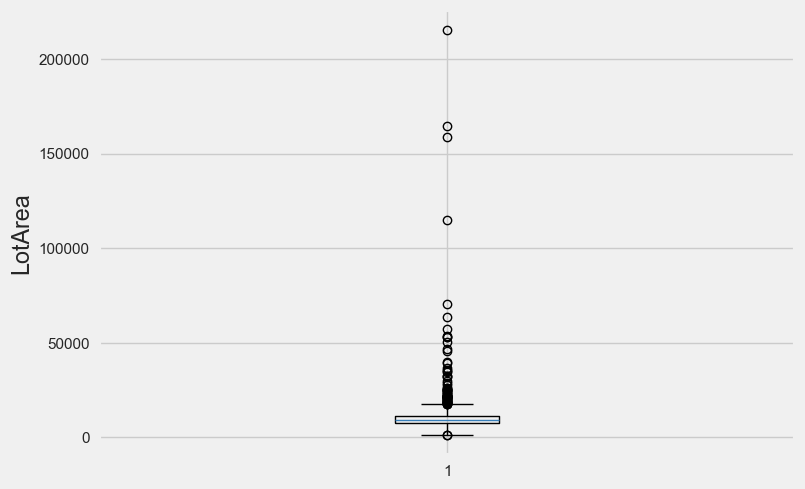

In [37]:
#create box plot to viz the distribution of a numeric col 
plt.boxplot(df['LotArea'])
plt.ylabel('LotArea')
plt.show()

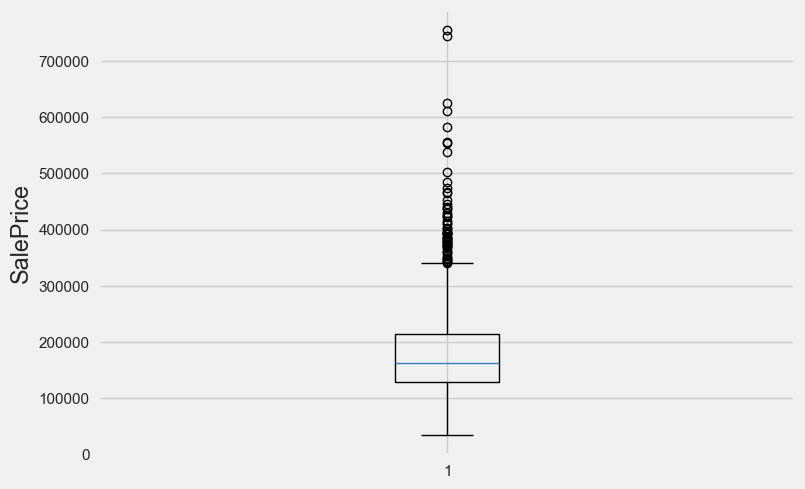

In [38]:
#create box plot to viz the distribution of a numeric col 
plt.boxplot(df['SalePrice'])
plt.ylabel('SalePrice')
plt.show()

Data Quality Issue: outliers 

In [39]:
from pandas.core.reshape.pivot import pivot_table
#create pivot table to summarize data 

# Question: which neighborhood has the highest average selling price? 

pivot_table = df.pivot_table(index = 'Neighborhood', columns='BldgType',
                             values = 'SalePrice', aggfunc = 'mean')

pivot_table.round(2)

BldgType,1Fam,2fmCon,Duplex,Twnhs,TwnhsE
Neighborhood,,,,,
Blmngtn,159895.00,NaN,NaN,NaN,197056.88
Blueste,NaN,NaN,NaN,151000.00,124000.00
BrDale,NaN,NaN,NaN,102408.33,110750.00
BrkSide,124881.70,123500.00,NaN,NaN,NaN
ClearCr,212565.43,NaN,NaN,NaN,NaN
CollgCr,201858.33,NaN,NaN,NaN,143470.00
Crawfor,208719.13,157000.00,145000.00,NaN,300833.33
Edwards,128402.10,110000.00,127612.50,132500.00,140750.00
Gilbert,193468.03,145000.00,NaN,NaN,NaN


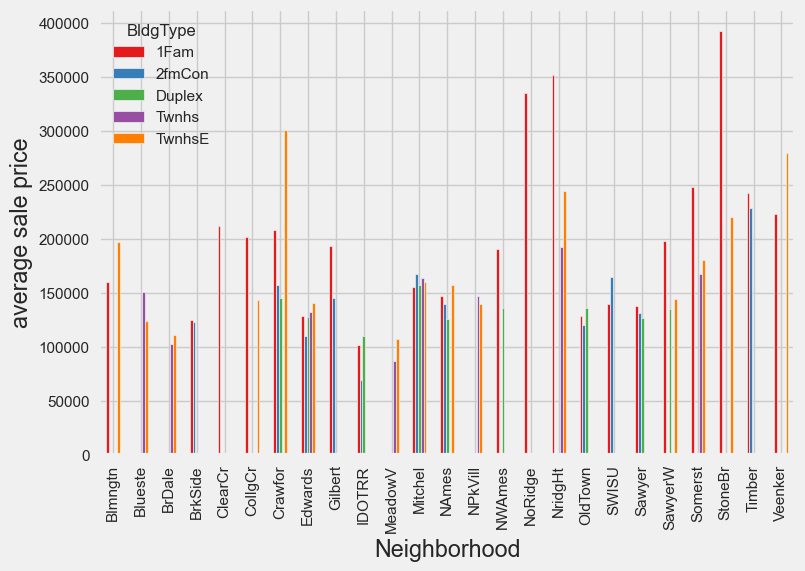

In [40]:
pivot_table.plot(kind='bar')
plt.ylabel('average sale price')
plt.show()

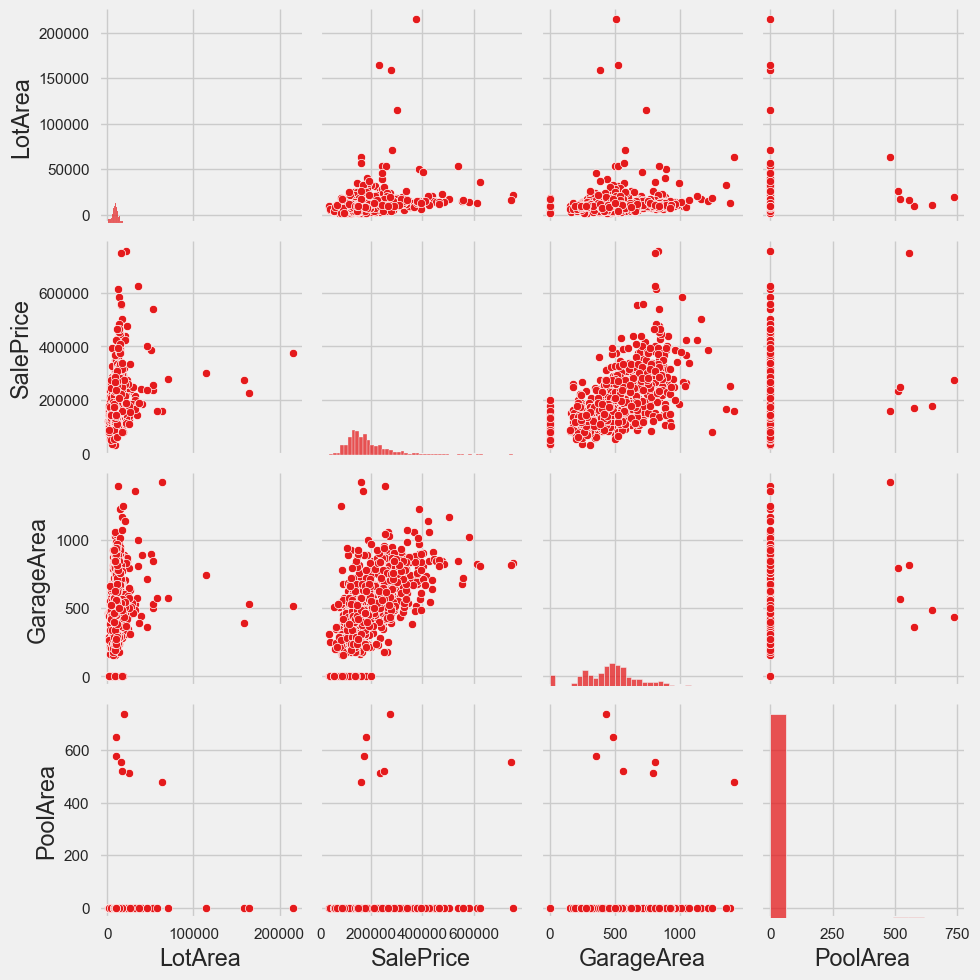

In [41]:
#create pairplot to visualize the relationship between multiple numeric cols
sns.pairplot(df, vars=['LotArea','SalePrice','GarageArea','PoolArea'])
plt.show()

In [28]:
!pip install autoviz

     ---------------------------------------- 64.7/64.7 kB ? eta 0:00:00
     ---------------------------------------- 1.4/1.4 MB 5.9 MB/s eta 0:00:00
     -------------------------------------- 240.9/240.9 kB 7.2 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 89.1/89.1 MB 6.6 MB/s eta 0:00:00
     -------------------------------------- 153.1/153.1 kB 8.9 MB/s eta 0:00:00
     ------------------------------------- 636.8/636.8 kB 13.3 MB/s eta 0:00:00
     ---------------------------------------- 12.9/12.9 MB 8.4 MB/s eta 0:00:00
     ---------------------------------------- 4.3/4.3 MB 8.3 MB/s eta 0:00:00
     ---------------------------------------- 4.3/4.3 MB 9.7 MB/s eta 0:00:00
     ---------------------------------------- 4.3/4.3 MB 8.2 MB/s eta 0:00:00
     ---------------------------------------- 4.3/4.3 MB 8.8 MB/s eta 0:00:00
     ------------------------------

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
spyder 5.2.2 requires pyqt5<5.13, which is not installed.
spyder 5.2.2 requires pyqtwebengine<5.13, which is not installed.
conda-repo-cli 1.0.20 requires clyent==1.2.1, but you have clyent 1.2.2 which is incompatible.
conda-repo-cli 1.0.20 requires nbformat==5.4.0, but you have nbformat 5.5.0 which is incompatible.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
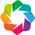

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine


In [29]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()

In [32]:
%matplotlib inline

Shape of your Data Set loaded: (1460, 81)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
Data cleaning improvement suggestions. Complete them before proceeding to ML modeling.


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
Id,1460,int64,0,0.000000,100.000000,0,possible ID column: drop
LotArea,1073,int64,0,0.000000,73.493151,0,
GrLivArea,861,int64,0,0.000000,58.972603,0,
BsmtUnfSF,780,int64,0,0.000000,53.424658,0,
1stFlrSF,753,int64,0,0.000000,51.575342,0,
TotalBsmtSF,721,int64,0,0.000000,49.383562,0,
SalePrice,663,int64,0,0.000000,45.410959,0,
BsmtFinSF1,637,int64,0,0.000000,43.630137,0,
GarageArea,441,int64,0,0.000000,30.205479,0,
2ndFlrSF,417,int64,0,0.000000,28.561644,0,


    81 Predictors classified...
        4 variables removed since they were ID or low-information variables
        List of variables removed: ['Id', 'Alley', 'PoolQC', 'MiscFeature']
3 numeric variables in data exceeds limit, taking top 30 variables
    List of variables selected: ['LotFrontage', 'MasVnrArea', 'GarageYrBlt']
   Total columns > 30, too numerous to print.
Number of All Scatter Plots = 6


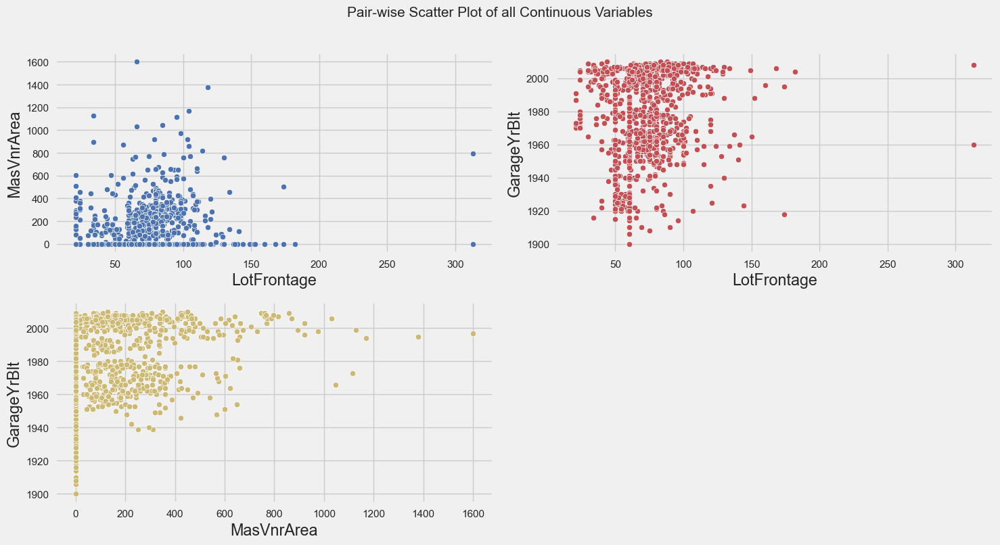

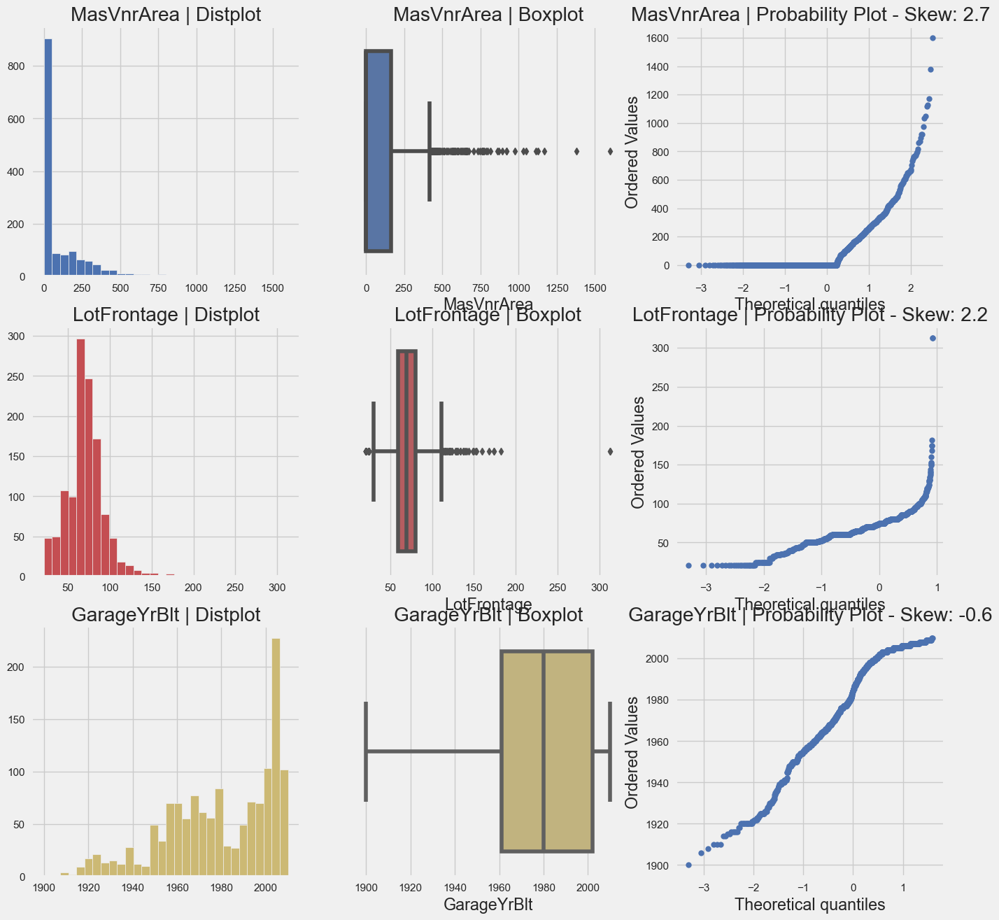

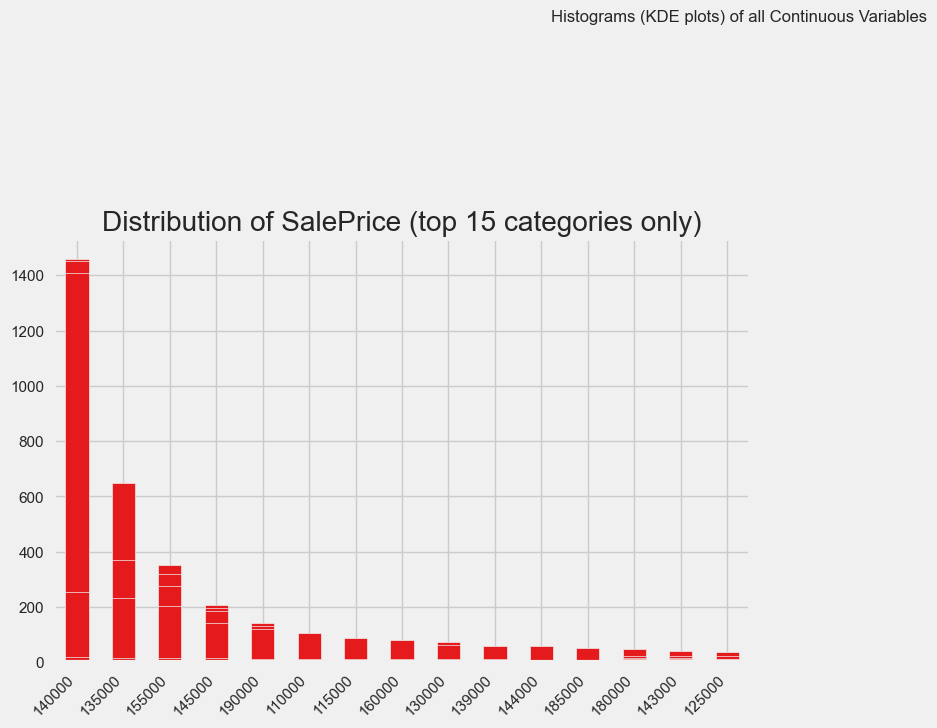

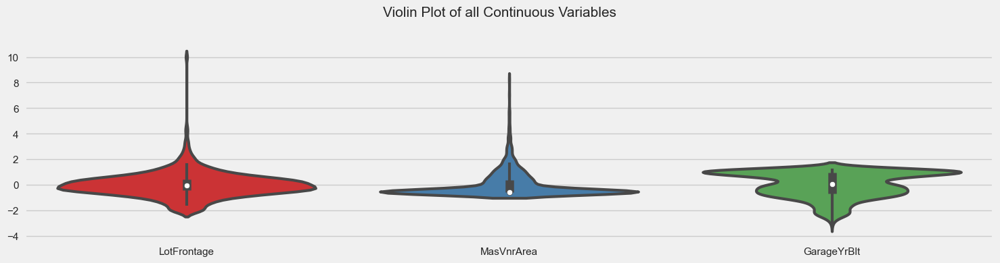

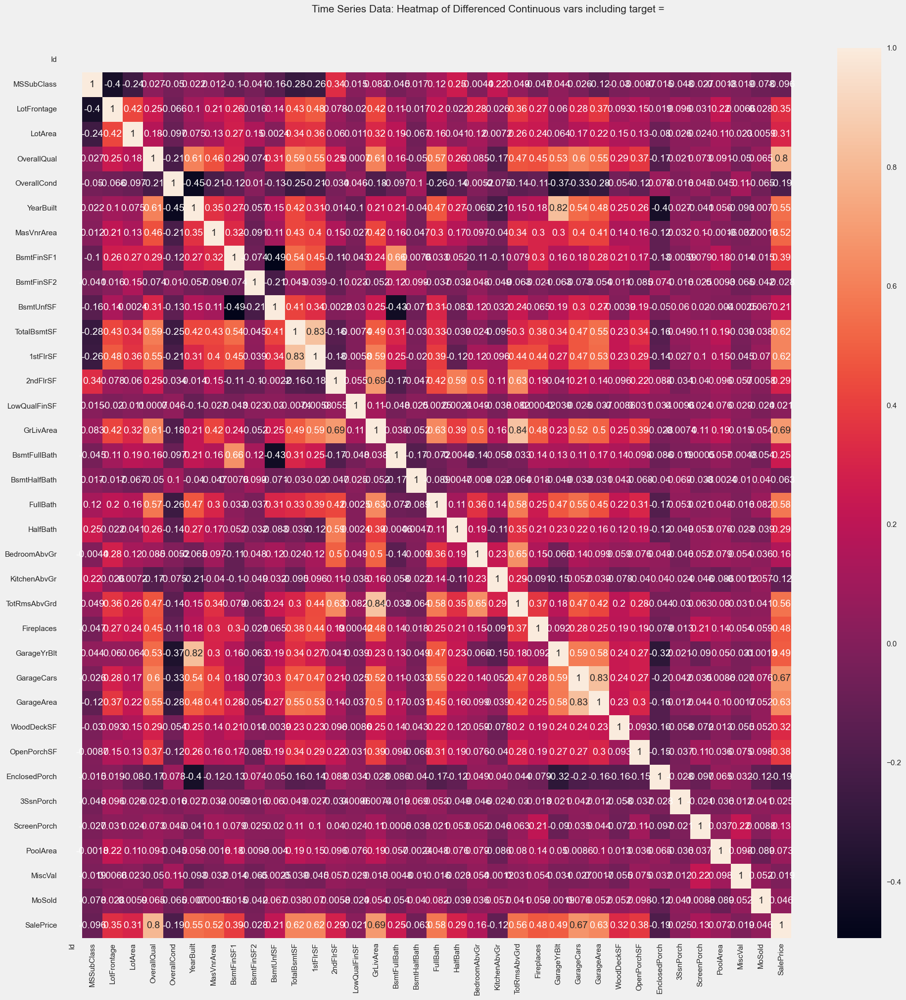

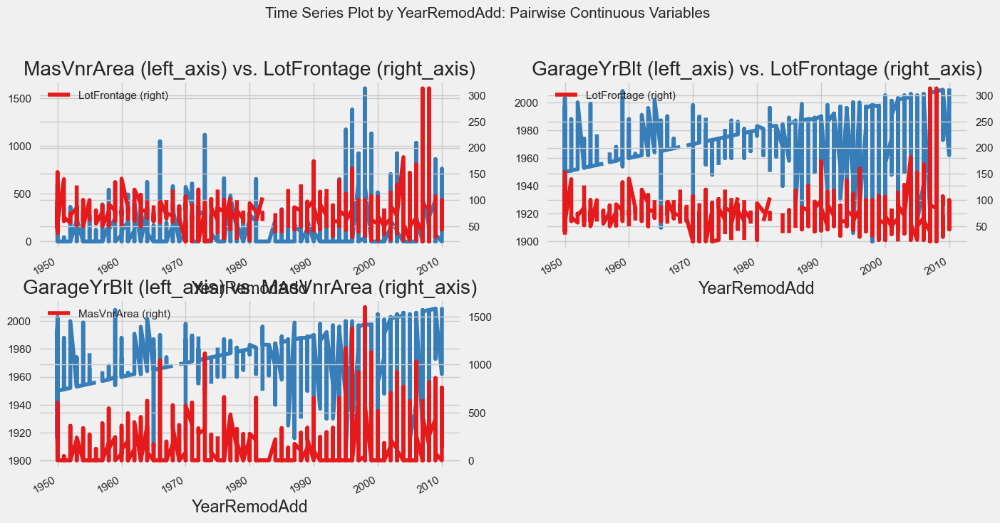

All Plots done
Time to run AutoViz = 26 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [33]:
#use AutoViz to visualize 
dft = AV.AutoViz('https://github.com/ArinB/MSBA-CA-Data/raw/main/CA01/house-price-train.csv')

Part 2: Data Pre-Processing

In [114]:
# create a copy of the original DataFrame 

df_copy = df.copy()

In [115]:
# handling missing values

#solution 1: drop columns with over 60% of missing values 

df_copy.loc[:,(df_copy.isnull().sum() / len(df_copy)).round(2) > 0.60]

df_copy = df_copy.drop(['Alley', 'PoolQC', 'Fence', 'MiscFeature'], axis = 1)

In [116]:
df_copy.shape

(1460, 77)

In [117]:
# handling missing values

#solution 2: Impute missing values with 'median'
df_copy.loc[:,(df_copy.isnull().sum() / len(df_copy)).round(2) > 0.10]

df_copy['LotFrontage'].fillna(df_copy['LotFrontage'].median(), inplace = True)

In [118]:
# handling missing values

#solution 3: drop columns with missing values
df_copy = df_copy.drop(['FireplaceQu'], axis = 1)

In [119]:
df_copy.shape #check shape 

(1460, 76)

In [120]:
df_copy.isna().values.any() #check NA 

True

In [121]:
df_na_col = [i for i in df_copy.columns if df_copy[i].isna().any()]
df_na_col

['MasVnrType',
 'MasVnrArea',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'Electrical',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageQual',
 'GarageCond']

In [122]:
df_copy.dropna(inplace = True)

In [123]:
# handling outliers 

#check descrptive statistic of 'LotArea' 
df_copy[['LotArea','SalePrice']].describe().round(2)

,LotArea,SalePrice
count,1338.00,1338.00
mean,10706.29,186761.78
std,10336.62,78913.85
min,1300.00,35311.00
25%,7744.00,135000.00
50%,9600.00,168500.00
75%,11760.75,220000.00
max,215245.00,755000.00


In [124]:
Q1=np.percentile(df_copy['LotArea'], 25,
                   interpolation = 'midpoint')
Q1

7746.0

In [125]:
Q3=np.percentile(df_copy['LotArea'], 75,
                   interpolation = 'midpoint')

In [126]:
IQR = Q3-Q1
IQR

4011.5

In [127]:
#set upper threshold 
upper_LotArea = df_copy['LotArea'] >= (Q3 + 1.5 * IQR)

lower_LotArea = df_copy['LotArea'] <= (Q1 - 1.5 * IQR)

In [128]:
df_copy['LotArea'][~(upper_LotArea | lower_LotArea)]

0        8450
1        9600
2       11250
3        9550
4       14260
        ...  
1455     7917
1456    13175
1457     9042
1458     9717
1459     9937
Name: LotArea, Length: 1262, dtype: int64

In [27]:
# encoding -> encode building type 
df_copy_encode = pd.get_dummies(df_copy.BldgType)
df_copy_encode

,1Fam,2fmCon,Duplex,Twnhs,TwnhsE
0,1,0,0,0,0
1,1,0,0,0,0
2,1,0,0,0,0
3,1,0,0,0,0
4,1,0,0,0,0
...,...,...,...,...,...
1455,1,0,0,0,0
1456,1,0,0,0,0
1457,1,0,0,0,0
1458,1,0,0,0,0


In [25]:
#IDness : duplicate removal -> checked duplicate 
df_copy.duplicated().sum()

0

**Part** 3: Data Post-Processing

In [ ]:
# Collinearity

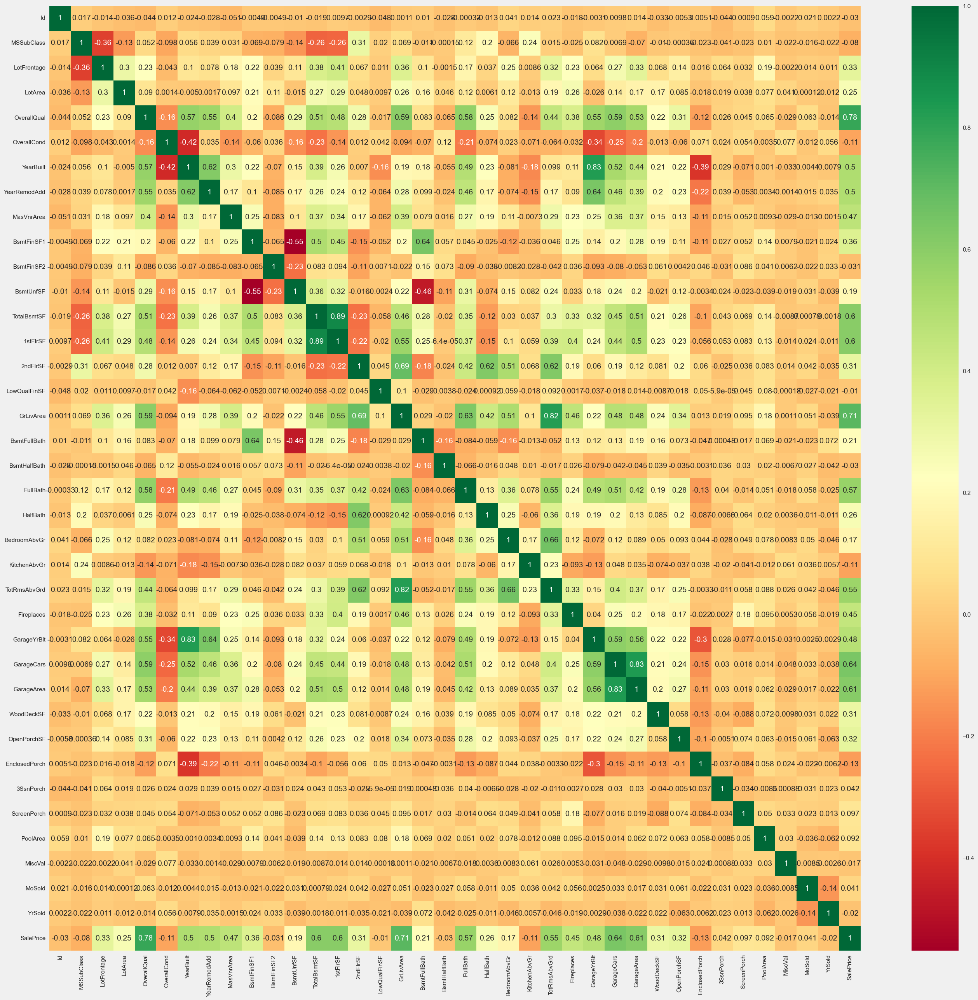

In [50]:
#create a heatmap to viz the correlation between multiple cols 
plt.figure(figsize=(30,30))
sns.heatmap(df_copy.corr(), cmap = 'RdYlGn', annot = True)
plt.show()

In [51]:
#feature selection 
df_copy_selected = df_copy[['GarageArea','SalePrice','LotArea','YearBuilt','FullBath','HalfBath']]
df_copy_selected

,GarageArea,SalePrice,LotArea,YearBuilt,FullBath,HalfBath
0,548,208500,8450,2003,2,1
1,460,181500,9600,1976,2,0
2,608,223500,11250,2001,2,1
3,642,140000,9550,1915,1,0
4,836,250000,14260,2000,2,1
...,...,...,...,...,...,...
1455,460,175000,7917,1999,2,1
1456,500,210000,13175,1978,2,0
1457,252,266500,9042,1941,2,0
1458,240,142125,9717,1950,1,0
